# Setup

In [2]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils import data
from torch.nn.modules.loss import _Loss
from torch.autograd import Variable, Function

from torchvision.datasets import ImageFolder
from torchvision import transforms, datasets

from PIL import Image
import numpy as np
import pandas as pd
from skimage.morphology import label
import matplotlib.pyplot as plt

# Constants

In [3]:
BATCH_SIZE = 64
IMG_PATH = '/home/yvan/projects/data_sci_bowl_2018/data'
N_EPOCHS = 10
FILTER_DEPTH = 1
LR = 0.0001

# Data Processing

In [4]:
#create a custom imageloader that gets the name of the file as well
class YvanImageFolder(ImageFolder):
    def __getitem__(self,index):
        return super(YvanImageFolder, self).__getitem__(index), self.imgs[index]

In [5]:
# data process
img_transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.Grayscale(),
    transforms.ToTensor(),
#     transforms.Normalize((0.5), (0.5))
])

img_dataset = YvanImageFolder(os.path.join(IMG_PATH, 'train_img'), img_transform)
img_loader = data.DataLoader(dataset=img_dataset,
                             batch_size=BATCH_SIZE,
                             shuffle=False,
                             num_workers=1)

In [6]:
# mask process
mask_transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.Grayscale(),
    transforms.ToTensor()
])

mask_dataset = YvanImageFolder(os.path.join(IMG_PATH,'train_mask'),mask_transform)
mask_loader = data.DataLoader(dataset=mask_dataset,
                              batch_size=BATCH_SIZE,
                              shuffle=False,
                              num_workers=1)

In [7]:
for (img, img_name), (mask, mask_name) in zip(img_loader, mask_loader):
    a,b = img[0], mask[0]
    test_img = transforms.ToPILImage()(a[0])
    test_mask = transforms.ToPILImage()(b[0])
    print(a.size(), b.size())
    print(torch.max(a[0]), torch.min(a[0]), torch.max(b[0]), torch.min(b[0]))
    break

torch.Size([64, 1, 128, 128]) torch.Size([64, 1, 128, 128])
0.40392157435417175 0.003921568859368563 1.0 0.0


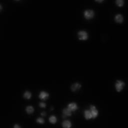

In [8]:
test_img

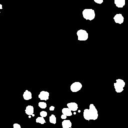

In [9]:
test_mask

Ok so we can convert our stuff into tensors and convert them back into images.

# Unet model

referenced: https://github.com/milesial/Pytorch-UNet/blob/master/unet/unet_parts.py

In [10]:
def rle_encoding(x):
    '''
    x: numpy array of shape (height, width), 1 - mask, 0 - background
    Returns run length as list
    '''
    dots = np.where(x.T.flatten()==1)[0] # .T sets Fortran order down-then-right
    run_lengths = []
    prev = -2
    for b in dots:
        if (b > prev+1): run_lengths.extend((b+1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

def rescale(X,xmin,xmax):
    _std = (X - X.min()) / (X.max() - X.min())
    return _std * (xmax - xmin) + xmin

def show_one(file):
    image = Image.open(file, 'r')
    plt.imshow(np.asarray(image))
    plt.axis('off')
    
def show_n(img_files, n=6):
    _, ax = plt.subplots(1, n, sharex='col', sharey='row', figsize=(24,6))
    
    for i, img_file in enumerate(img_files):
        ax[i].imshow(img_file)
        ax[i].axis('off')

def chunker(seq, size):
    return (seq[pos:pos + size] for pos in range(0, len(seq), size))

def check_param_sum(model):
    return sum([torch.sum(param).data[0] for param in model.parameters()])

def to_variable(x):
    if torch.cuda.is_available():
        x = x.cuda()
    return Variable(x)

class DiceCoeff(Function):
    def forward(self, input, target):
        self.save_for_backward(input, target)
        self.inter = torch.dot(input, target) + 0.0001
        self.union = torch.sum(input) + torch.sum(target) +0.0001
        
        t = 2*self.inter.float()/self.union.float()
        return t
    
    def backward(self, grad_output):
        input,target = self.saved_variables
        grad_input = grad_target = None
        if self.needs_input_grad[0]:
            grad_input = grad_output *2* (target * self.union + self.inter) / self.union*self.union
            
        if self.needs_input_grad[1]:
            grad_target = None
        return grad_input, grad_target
    
def dice_coeff(input, target):
    if input.is_cuda:
        s = Variable(torch.FloatTensor(1).cuda().zero_())
    else:
        s = Variable(torch.FloatTensor(1).zero_())
        
    for i,c in enumerate(zip(input, target)):
        s = s + DiceCoeff().forward(c[0], c[1])
        
    return s / (i+1)

class DiceLoss(_Loss):
    def forward(self, input, target):
        return 1 - dice_coeff(F.sigmoid(input), target)
    
### conv building block ###

class conv_block(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(conv_block, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_chan, out_chan, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(out_chan, out_chan, 3, padding=1),
            nn.ReLU()
        )
        
    def forward(self, x):
        x = self.conv(x)
        return x

### inputs and outputs ###

class in_conv(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(in_conv, self).__init__()
        self.conv = conv_block(in_chan, out_chan)
        
    def forward(self, x):
        x = self.conv(x)
        return x
        
class out_conv(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(out_conv, self).__init__()
        self.conv = nn.Conv2d(in_chan, out_chan, 1)
        self.activation = nn.Sigmoid()
        
    def forward(self, x):
        x = self.conv(x)
        x = self.activation(x)
        return x
    
### actual con blocks ###

class conv_down(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(conv_down, self).__init__()
        self.pool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            conv_block(in_chan, out_chan)
        )
        
    def forward(self, x):
        x = self.pool_conv(x)
        return x

class conv_up(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(conv_up, self).__init__()
        self.conv_up = nn.ConvTranspose2d(in_chan, out_chan, 2, stride=2)
        self.conv = conv_block(in_chan+out_chan, out_chan)
    
    def forward(self, x1, x2):
        x1 = self.conv_up(x1)
        x = torch.cat([x2,x1],dim=1)
        x = self.conv(x)
        return x

class unet1(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(unet1, self).__init__()
        self.inc = in_conv(in_chan, 64)
        self.down1 = conv_down(64, 128)
        self.down2 = conv_down(128, 256)
        self.down3 = conv_down(256, 512)
        self.down4 = conv_down(512, 512)
        self.up1 = conv_up(512, 256)
        self.up2 = conv_up(256, 128)
        self.up3 = conv_up(128, 64)
        self.up4 = conv_up(64, 32)
        self.out = out_conv(32, out_chan)
        
    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.out(x)
        return x

In [11]:
# create a unet
unet = unet1(FILTER_DEPTH, FILTER_DEPTH)
opti = optim.Adam(unet.parameters(), lr=LR, betas=(0.5,0.99))
loss = DiceLoss()

nparams = sum([param.nelement() for param in unet.parameters()])
psum = check_param_sum(unet)
print(f'creating model with {nparams} params and intial param sum {psum}')

if torch.cuda.is_available():
    unet.cuda()
    loss.cuda()

losses = []

for epoch in range(N_EPOCHS*5):
    epoch_loss = []
    if not epoch % 10: print(f'training epoch {epoch}')
    for (batch, batch_name), (mask_batch, mask_name) in zip(img_loader, mask_loader):
        image_batch = to_variable(batch[0])
        labels = to_variable(mask_batch[0])
        # in 64, 3, 128, 128
        batch_size = image_batch.size(0)
        # out 64, 3, 64, 64
        x = unet(image_batch)
        l = loss(x, labels)
        epoch_loss.append(l.data[0])
        l.backward()
        opti.step()
        unet.zero_grad()
    losses.append(np.mean(epoch_loss))
    epoch_loss = []
    
print(losses)

creating model with 13235073 params and intial param sum -2.2156509701162577
training epoch 0
training epoch 10
training epoch 20
training epoch 30
training epoch 40
[0.7941410649906505, 0.7935443954034285, 0.7901293689554388, 0.7818757133050398, 0.7756446925076571, 0.7724771445447748, 0.7693552429025824, 0.7652062502774325, 0.762147372419184, 0.7602830529212952, 0.7576667720621283, 0.7570154016668146, 0.7565350153229453, 0.7587753642689098, 0.7593556967648593, 0.7573238502849232, 0.7558863867412914, 0.7554201050238176, 0.7550786245952953, 0.7548348361795599, 0.7541788979010149, 0.7536487200043418, 0.7533892772414468, 0.7525953325358304, 0.7521049542860552, 0.7518413229422136, 0.7520258047363975, 0.7465602322058245, 0.7457918253811923, 0.7458935217423872, 0.7447952899065885, 0.7444336089220914, 0.7441729361360724, 0.7440411069176414, 0.7433438246900385, 0.7437984347343445, 0.7430887764150446, 0.7431612610816956, 0.7429797107523138, 0.7428056814453818, 0.7429377274079756, 0.742386281490

In [12]:
check_param_sum(unet)

-1095.291497118771

# Examining Predictions

In [13]:
predicted_masks = []
actual_masks = []
names = []
for (batch, batch_name), (mask_batch, mask_name) in zip(img_loader, mask_loader):
    image_batch = to_variable(batch[0])
    labels = to_variable(mask_batch[0])
    names.extend(batch_name[0])
    x = unet(image_batch)
    for i, l in zip(x.data, labels.data):
        predicted_masks.append(transforms.ToPILImage()(i.cpu()))
        actual_masks.append(transforms.ToPILImage()(l.cpu()))

In [14]:
assert len(predicted_masks) == len(actual_masks)

In [15]:
assert len(predicted_masks) == len(names)

/home/yvan/anaconda3/envs/data_sci_bowl_2018/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


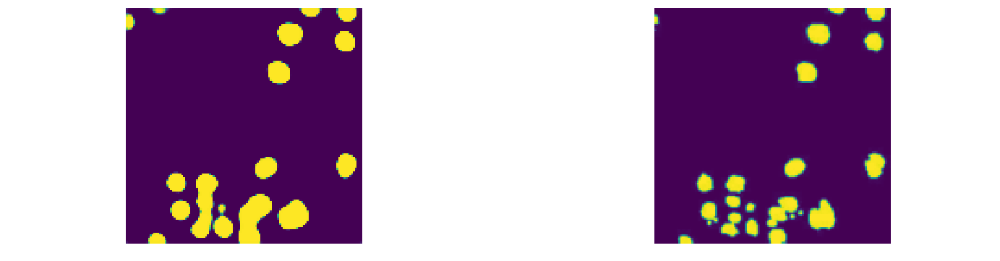

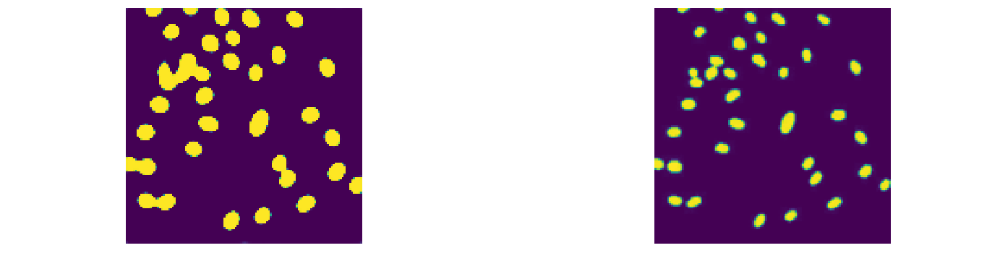

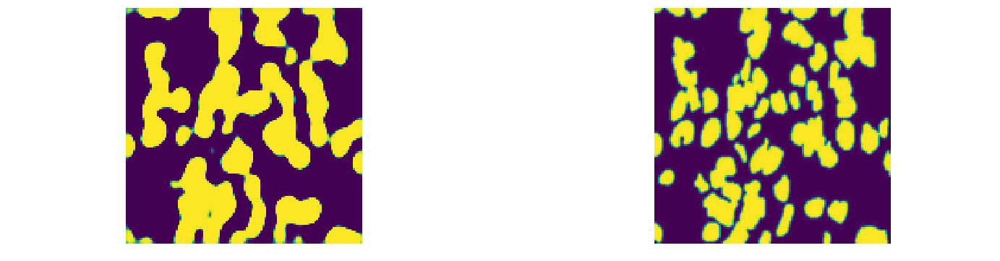

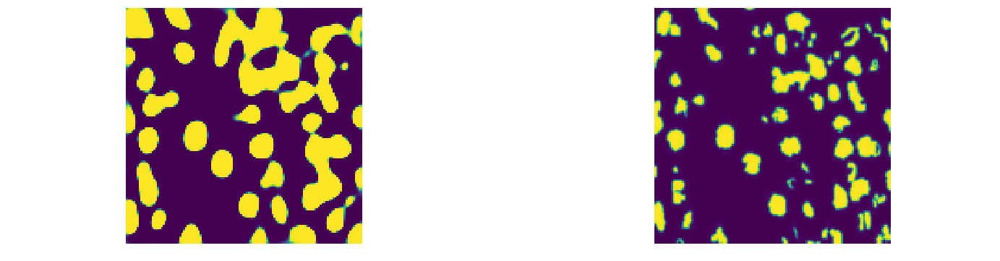

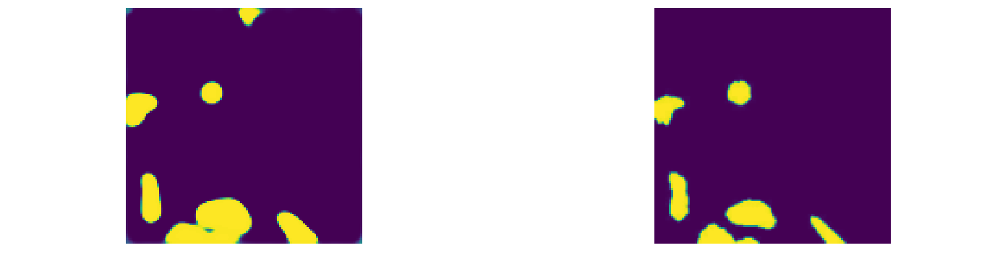

...

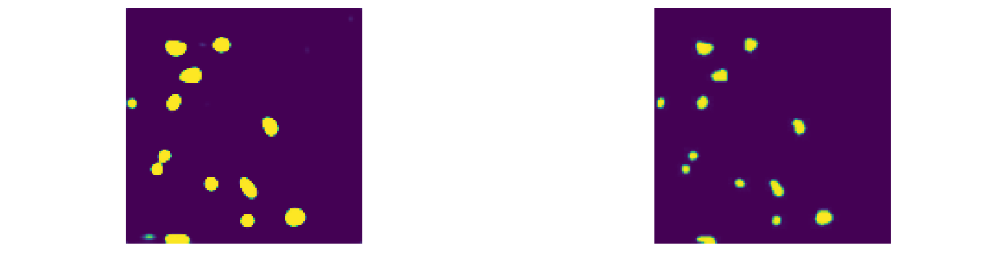

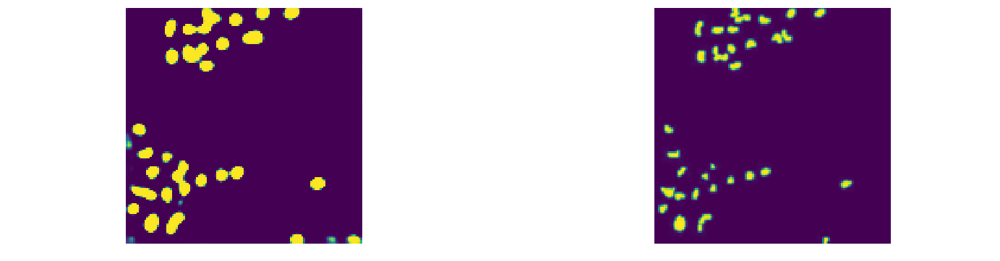

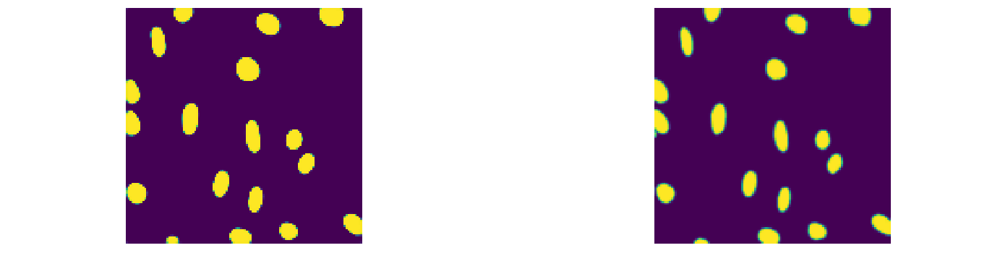

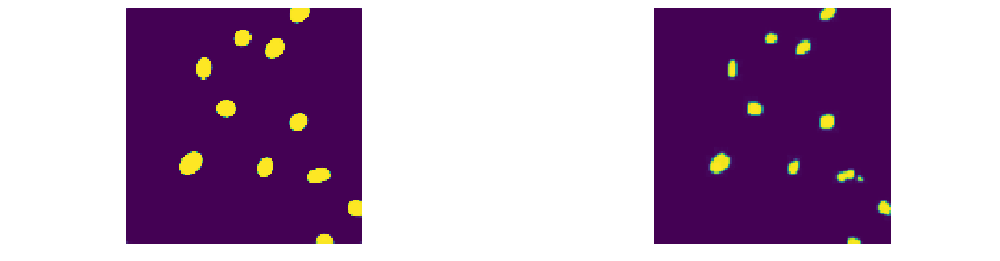

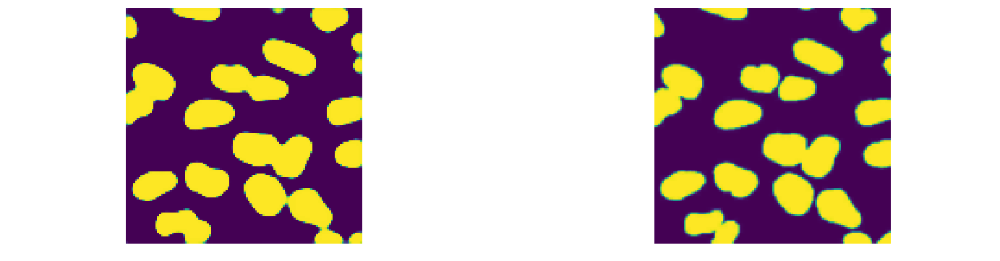

In [16]:
def show_n(img_files, n=6):
    _, ax = plt.subplots(1, n, sharex='col', sharey='row', figsize=(24,6))
    
    for i, img_file in enumerate(img_files):
        ax[i].imshow(img_file)
        ax[i].axis('off')
        
for pred,actual in zip(predicted_masks, actual_masks):
    show_n([np.asarray(pred), np.asarray(actual)],n=2)

# Check run length encoding values with training labels

We need a mean IOU metric, and then calculate our RLEs on training data, byt splitting stuff up and then compare our RLEs agiant she given RLEs from the labels csv file.

In [17]:
rles = []

for name,p,a in zip(names,predicted_masks,actual_masks):    
    pred_slide = np.asarray(p.convert('1'))
    grouped_cells = label(pred_slide)
    group_vals, group_counts = np.unique(grouped_cells, return_counts=True)
    name = os.path.splitext(os.path.basename(name))[0].split('_')[0]
    for group_val in range(1,group_vals.max()+1):
        rle = rle_encoding(grouped_cells == group_val)
        str_rle = ' '.join([str(r) for r in rle])
        rles.append({'ImageId': name, 'EncodedPixels':str_rle})
        
train_rles = pd.DataFrame.from_dict(rles)
train_rles.tail()

,EncodedPixels,ImageId
14889,4185 7 4311 11 4438 13 4565 15 4693 16 4821 16...,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...
14890,608 7 735 9 862 10 989 12 1116 13 1244 14 1371...,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...
14891,8289 5 8415 9 8542 12 8669 14 8796 17 8924 18 ...,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...
14892,2165 4 2290 9 2417 11 2544 13 2672 13 2800 13 ...,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...
14893,15488 1 15613 4 15740 5 15867 6 15995 6 16123 ...,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...


In [18]:
train_labels = pd.read_csv(os.path.join(IMG_PATH, 'stage1_train_labels.csv/stage1_train_labels.csv'))
train_labels.tail()

,ImageId,EncodedPixels
29456,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...,31317 2 31676 5 32035 6 32394 7 32753 8 33112 ...
29457,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...,110318 4 110675 13 111034 19 111391 23 111750 ...
29458,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...,24841 1 25201 2 25561 2 25921 3 26281 4 26641 ...
29459,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...,4061 8 4417 14 4775 21 5134 23 5494 24 5853 26...
29460,ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d...,80876 11 81234 15 81590 20 81948 23 82305 27 8...


In [64]:
g = np.array(pred) & np.array(actual)

In [87]:
np.array(pred)

array([[ 22,   4,   1, ...,   1,   2,  15],
       [  5,   0,   0, ...,   0,   0,   3],
       [  5,   0,   0, ...,   0,   0,   1],
       ...,
       [  1,   0,   0, ..., 254, 254, 254],
       [  3,   0,   0, ..., 254, 254, 252],
       [ 18,   3,   1, ..., 254, 252, 234]], dtype=uint8)

In [85]:
Image.fromarray(np.array(pred)).mode

'L'

In [46]:
thresholds = np.arange(0.5, 1.0, 0.05)
tp = np.zeros(len(thresholds))
fn_fp = np.zeros(len(thresholds))

for name,pred,actual in zip(names,predicted_masks,actual_masks):
    print(pred,actual)
    overlap =  
    
    for i, t in enumerate(thresholds):
        if overlap > t: #true positive
            tp[i] += 1
        else:
            fn_fp[i] += 1
    break
        

<PIL.Image.Image image mode=L size=128x128 at 0x7F0FDA0E3CC0> <PIL.Image.Image image mode=L size=128x128 at 0x7F0FDA0E36D8>


NameError: name 'overlap' is not defined

# generating test predictions

In [63]:
test_transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.Grayscale(),
    transforms.ToTensor()
])


test_transform_size = transforms.Compose([
    transforms.ToTensor()
])

test_dataset = YvanImageFolder(os.path.join(IMG_PATH, 'test_img'), test_transform)
test_loader = data.DataLoader(dataset=test_dataset,
                             batch_size=BATCH_SIZE,
                             shuffle=False,
                             num_workers=1)


test_sizes = YvanImageFolder(os.path.join(IMG_PATH, 'test_img'), test_transform_size)
test_sizes_loader = data.DataLoader(dataset=test_sizes,
                             batch_size=1,
                             shuffle=False,
                             num_workers=1)

In [64]:
sizes_in_order = [tuple(batch[0].size()[2:]) for batch, paths in test_sizes_loader]

In [92]:
predicted_names = []
predicted_test = []
ct = 0

for batch, paths in test_loader:
    predicted_names += list(paths[0])
    image_batch = to_variable(batch[0])
    x = unet(image_batch)
    for i in x.data:
        size = sizes_in_order[ct]
        im = transforms.ToPILImage(mode='L')(i.cpu())
        im = im.resize((size[1], size[0]))
        predicted_test.append(im)
        ct += 1

In [93]:
for i in range(len(sizes_in_order)): 
    assert sizes_in_order[i] == np.asarray(predicted_test[i].convert('1')).shape

In [2]:
predicted_test[7]

NameError: name 'predicted_test' is not defined

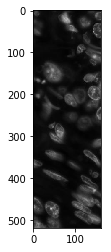

In [95]:
_ = plt.imshow(Image.open(predicted_names[10]))

How many unique regions can we find using label (a class that automatically segments images):

In [96]:
test_label = label(np.asarray(predicted_test[10].convert('1')))
np.unique(test_label, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
        85, 86, 87, 88, 89, 90, 91, 92]),
 array([49135,  1286,     1,  1659,  2001,     1,     1,     1,     1,
            1,     1,     1,     1,     1,     1,     1,     3,     1,
            1,  2215,     1,     1,     1,     1,     1,   107,     1,
            1,  3034,     1,  7271,     1,     1,     1,     1,     1,
            1,     1,     1,   329,     1,  1125,     1,     1,     1,
            1,     1,     1,     2,     1,  1555,   506,   974,  1016,
            1,     1,     1,     1,     1,   467,   589,     1,     1,
            1,     1,     1,     1,  1277,     1,   163,     1,     1,
         5

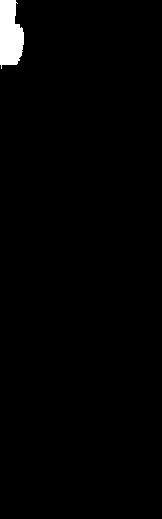

In [97]:
Image.fromarray((test_label == 1).astype('uint8')*255)

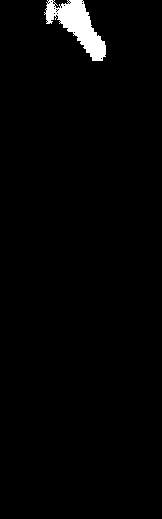

In [98]:
Image.fromarray((test_label == 3).astype('uint8')*255)

Ok so that's each mask. What well want to do is generate a run lenght encoding for each segmented mask (basically a mask for each cell on each slide, and then run lenght encode this single cell mask). Notice that several of the groups contain 1 pixel, probably should omit those in the future.

Don't want to look at any more test exmaples. Just want to verify that 1-2 seem right.

# make a submission

In [1]:
import pandas as pd

def rle_encoding(x):
    dots = np.where(x.T.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

def prob_to_rles(x, cutoff=0.5):
    lab_img = label(x > cutoff)
    for i in range(1, lab_img.max() + 1):
        yield rle_encoding(lab_img == i)

test_names = []
test_rles = [] 
for i, (p, path) in enumerate(zip(predicted_test, predicted_names)):
    supposed_size = sizes_in_order[i]
    pred_slide = np.asarray(np.array(p)/255)
    name = os.path.splitext(os.path.basename(path))[0].split('_')[0]
    rles = list(prob_to_rles(pred_slide))
    test_rles.extend(rles)
    test_names.extend([name]*len(rles))

NameError: name 'predicted_test' is not defined

In [103]:
sub = pd.DataFrame()
sub['ImageId'] = test_names
sub['EncodedPixels'] = pd.Series(test_rles).apply(lambda x: ' '.join(str(y) for y in x))
sub.tail(n=15)

,ImageId,EncodedPixels
825,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,56979 14 57235 14 57489 20 57745 20 58001 20 5...
826,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,17563 8 17819 8 18073 12 18329 12 18585 12 188...
827,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,38555 12 38811 12 39063 18 39319 18 39573 22 3...
828,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,30371 10 30627 10 30879 16 31135 16 31389 20 3...
829,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,25763 6 26019 6 26273 10 26529 10 26783 14 270...
830,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,2743 10 2999 10 3253 14 3509 14 3765 14 4021 1...
831,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,16571 6 16827 6 17081 10 17337 10 17591 14 178...
832,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,15063 10 15319 10 15573 14 15829 14 16085 14 1...
833,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,41179 8 41435 8 41689 12 41945 12 42199 16 424...
834,fe9adb627a6f45747c5a8223b671774791ededf9364f65...,20709 10 20965 10 21219 12 21475 12 21729 16 2...


In [101]:
sub.to_csv(os.path.join(IMG_PATH, 'submissions','feb202018_7.csv'), index=False)

Ok now im not in dead last which is guess is nice. Ok now this 3rd submission produces 0.06.

These look better than i thought they would.

What did we learn here?

1 - Some of the predictions are inverted and that should probably be somethig we look at at some point. Some of the predictions are all white. worth invertigating.

2 - RLE encoding fuz images is bad. We'll probably want to threshold the values in our prediction. It could be interesting to try to learn how to do this. (solved mostly buy using a sigmoid instead of relu as the final activation).

3 - So instead of just rounding stuff we train an algorithm whose job is to only work on edge pixels (between 0.4-0.6) and try to deterimine whether or not they should be in the final mask.

Tasks:

```
Fix wtvr the fuck is wrong with my encoding procedure, read kernels.
Improve the model by sabilizing the loss: better loss (iou), BCE diceloss.
Improve model by adding dropouts.
Imporev end result by ensembling.
Adde a model that moves from lower quality images to higher resolution 256, basically instaed of just upsampling, train a model (watch out for overfitting).
Make the model output bigger stuff.
Try unet variants.

check out: https://www.kaggle.com/c/data-science-bowl-2018/discussion/49692 (LB 0.463)

more thoughts:

The threshold of the prediction pixcel is hard to determined. I think the OSTU adative threshold could be useful for the prediction.

The prediction would make some very sparse pixel which should not be consider as a Nuclei. Thus a Low pass filter or Markov Random Field could be apply to expel those pixels

How to regenerate a reliable seperated mask from the concatenated mask. the result generated by morphology from skimage is not reliable for cell that has interception.
```